## PROBLEM STATEMENT

### Domain : Exploratory Data Analysis

#### Objective : Global Terrorism Analysis
- Find out the hot zones of terrorism.
- What all security issues and insights you can derive by Exploratory Data Analysis?


**Learning Outcome:**

                * Exploratory Data Analysis
                * Descriptive Statistics
                * Data Visualization
                * Preparing the data to train a model
                * Training and making predictions using an Ensemble Model
**Technical Stack:** numpy, pandas, matplotlib, seaborn

#### 1. Importing necessary libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns ; sns.set(color_codes = True)
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [2]:
# To determine the versions of the packages
print(np.__version__)
print(pd.__version__)
print(sns.__version__)

1.20.3
1.3.4
0.11.2


#### 2. Loading the DataSet and extracting Informations from it i.e Understanding the Data

In [3]:
terr_df = pd.read_csv("globalterrorismdb_0718dist.csv",encoding='ISO-8859-1')
print("Data imported successfully \n \n");
print('The no. of rows is' ,terr_df.shape[0], 'and The no. of columns is', terr_df.shape[1],"\n\n")
print("Sample of the dataset :: \n \n ");
terr_df.head()

Data imported successfully 
 

The no. of rows is 181691 and The no. of columns is 135 


Sample of the dataset :: 
 
 


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [4]:
terr_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [5]:
terr_df.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [6]:
terr_df.dtypes

eventid        int64
iyear          int64
imonth         int64
iday           int64
approxdate    object
               ...  
INT_LOG        int64
INT_IDEO       int64
INT_MISC       int64
INT_ANY        int64
related       object
Length: 135, dtype: object

Using **describe()** function calculating the various numerical descriptions of the data like count, mean, standard deviation, minimum and maximum values and percentile values.

In [7]:
terr_df.describe().T

,count,mean,std,min,25%,50%,75%,max
eventid,181691.0,2.002705e+11,1.325957e+09,1.970000e+11,1.991021e+11,2.009022e+11,2.014081e+11,2.017123e+11
iyear,181691.0,2.002639e+03,1.325943e+01,1.970000e+03,1.991000e+03,2.009000e+03,2.014000e+03,2.017000e+03
imonth,181691.0,6.467277e+00,3.388303e+00,0.000000e+00,4.000000e+00,6.000000e+00,9.000000e+00,1.200000e+01
iday,181691.0,1.550564e+01,8.814045e+00,0.000000e+00,8.000000e+00,1.500000e+01,2.300000e+01,3.100000e+01
extended,181691.0,4.534622e-02,2.080629e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
...,...,...,...,...,...,...,...,...
nreleased,10400.0,-2.901827e+01,6.572012e+01,-9.900000e+01,-9.900000e+01,0.000000e+00,1.000000e+00,2.769000e+03
INT_LOG,181691.0,-4.543731e+00,4.543547e+00,-9.000000e+00,-9.000000e+00,-9.000000e+00,0.000000e+00,1.000000e+00
INT_IDEO,181691.0,-4.464398e+00,4.637152e+00,-9.000000e+00,-9.000000e+00,-9.000000e+00,0.000000e+00,1.000000e+00
INT_MISC,181691.0,9.000996e-02,5.684573e-01,-9.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00


Using **isnull()** function in pandas and sum function Let us calculate the total **NULL** values in each columns of the terrorism dataset

In [8]:
terr_df.isnull().sum()

eventid            0
iyear              0
imonth             0
iday               0
approxdate    172452
               ...  
INT_LOG            0
INT_IDEO           0
INT_MISC           0
INT_ANY            0
related       156653
Length: 135, dtype: int64

In [9]:
#Using corr() function in pandas displaying the pairwise correlation of all columns in the pandas dataframe 
# i.e in our Iris dataframe.
terr_df.corr()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,...,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
eventid,1.000000,0.999996,0.002706,0.018336,0.091761,-0.135039,0.401371,0.166886,0.003907,0.030641,...,-0.009990,-0.018001,-0.014094,-0.165422,0.256113,-0.181612,-0.143600,-0.133252,-0.077852,-0.175605
iyear,0.999996,1.000000,0.000139,0.018254,0.091754,-0.135023,0.401384,0.166933,0.003917,0.030626,...,-0.009984,-0.018216,-0.014238,-0.165375,0.256092,-0.181556,-0.143601,-0.133253,-0.077847,-0.175596
imonth,0.002706,0.000139,1.000000,0.005497,-0.000468,-0.006305,-0.002999,-0.015978,-0.003880,0.003621,...,-0.000710,0.046989,0.058878,-0.016597,0.011295,-0.011535,-0.002302,-0.002034,-0.002554,-0.006336
iday,0.018336,0.018254,0.005497,1.000000,-0.004700,0.003468,0.009710,0.003423,-0.002285,-0.006991,...,0.012755,-0.010502,0.003148,-0.006581,-0.006706,0.001765,-0.001540,-0.001621,-0.002027,-0.001199
extended,0.091761,0.091754,-0.000468,-0.004700,1.000000,-0.020466,0.038389,-0.024749,0.000523,0.057897,...,-0.008114,0.028177,0.001966,0.009367,0.233293,-0.192155,0.071768,0.075147,0.027335,0.080767
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
nreleased,-0.181612,-0.181556,-0.011535,0.001765,-0.192155,-0.044331,-0.149511,0.002790,-0.017745,-0.030631,...,0.054571,0.034843,0.049322,0.016832,-0.555478,1.000000,0.039388,0.040947,0.085055,0.064759
INT_LOG,-0.143600,-0.143601,-0.002302,-0.001540,0.071768,0.069904,-0.082584,-0.099827,0.002272,0.073022,...,0.035821,0.031079,0.007029,-0.045504,-0.015442,0.039388,1.000000,0.996211,0.052537,0.891051
INT_IDEO,-0.133252,-0.133253,-0.002034,-0.001621,0.075147,0.067564,-0.071917,-0.094470,0.002268,0.071333,...,0.039053,0.041983,0.013162,-0.039844,-0.016234,0.040947,0.996211,1.000000,0.082014,0.893811
INT_MISC,-0.077852,-0.077847,-0.002554,-0.002027,0.027335,0.207281,0.043139,0.097652,0.000371,-0.019197,...,0.023815,0.125162,0.037227,0.129274,-0.119776,0.085055,0.052537,0.082014,1.000000,0.252193


#### 3. Data Preprocessing

**Deleting the unnecessary values and columns from our dataset** which are not required for our analysis purpose.

And this can be done by **drop()** function passed with attributes

In [10]:
df_new=terr_df.drop(['eventid','resolution','approxdate', 'extended', 'region',
         'specificity','vicinity','location','crit1','crit2',
         'crit3','doubtterr','alternative','alternative_txt',
         'multiple','attacktype2_txt','attacktype3','attacktype3_txt',
         'natlty1','natlty1','natlty1_txt','targtype2','targtype2_txt',
         'targsubtype2','targsubtype2_txt','corp2','target2','natlty2','natlty2_txt',
         'targtype3','targtype3_txt','targsubtype3','targsubtype3_txt','corp3',
         'target3','natlty3','natlty3_txt','gsubname','gname2','gsubname2','gname3',
         'gsubname3','guncertain1','guncertain2','guncertain3','individual','nperps','nperpcap',	
         'claimed','claimmode','claimmode_txt','claim2','claimmode2','claimmode2_txt','claim3',
         'claimmode3','claimmode3_txt','compclaim','weapsubtype1','weapsubtype1_txt','weaptype2',
         'weaptype2_txt','weapsubtype2','weapsubtype2_txt','weaptype3',	
         'weaptype3_txt','weapsubtype3','weapsubtype3_txt','weaptype4','weaptype4_txt','weapsubtype4','weapsubtype4_txt',
         'nkillter','nwoundus','nwoundte','property','propextent','propextent_txt','propvalue','propcomment','ishostkid','nhostkid',	
         'nhostkidus','nhours','ndays','divert','kidhijcountry','ransom','ransomamt','ransomamtus','ransompaid','ransompaidus','ransomnote',
         'hostkidoutcome','hostkidoutcome_txt','nreleased','addnotes','scite1','scite2','scite3','dbsource','INT_LOG','INT_IDEO',
         'INT_MISC','INT_ANY','related'],axis=1)

To make the code readable modifying the name of the attributes / columns as per our ease using **rename()** function

In [11]:
df_new.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','provstate':'State',
                          'region_txt':'Region','attacktype1_txt':'Attack_Type','target1':'Target','nkill':'Killed',
                          'nwound':'Wounded','gname':'Group','targtype1_txt':'Target_Type',
                          'weaptype1_txt':'Weapon_type','latitude':'Latitude',
                          'longitude':'Longitude','target1':'Target','city':'City'},inplace=True)

In [12]:
# Checking the sample of new dataset formed after modification
df_new.head()

,Year,Month,Day,country,Country,Region,State,City,Latitude,Longitude,...,corp1,Target,Group,motive,weaptype1,Weapon_type,weapdetail,Killed,nkillus,Wounded
0,1970,7,2,58,Dominican Republic,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,...,NaN,Julio Guzman,MANO-D,NaN,13,Unknown,NaN,1.0,NaN,0.0
1,1970,0,0,130,Mexico,North America,Federal,Mexico city,19.371887,-99.086624,...,Belgian Ambassador Daughter,"Nadine Chaval, daughter",23rd of September Communist League,NaN,13,Unknown,NaN,0.0,NaN,0.0
2,1970,1,0,160,Philippines,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,...,Voice of America,Employee,Unknown,NaN,13,Unknown,NaN,1.0,NaN,0.0
3,1970,1,0,78,Greece,Western Europe,Attica,Athens,37.997490,23.762728,...,NaN,U.S. Embassy,Unknown,NaN,6,Explosives,Explosive,NaN,NaN,NaN
4,1970,1,0,101,Japan,East Asia,Fukouka,Fukouka,33.580412,130.396361,...,NaN,U.S. Consulate,Unknown,NaN,8,Incendiary,Incendiary,NaN,NaN,NaN


Now let us find out the total percentage of the missing values in our Dataset.
This can be done by using the **isnull()** and **sum()** functions on our dataset

In [13]:
# percentage of missing values in our dataset
missing_values = (((terr_df.isnull().sum()).sum())/terr_df.size)*100
print("{0:.2f}".format(missing_values),"%")

56.48 %


As we can see form above that on approx 57 % of the values of the dataset is null value. So, for effective analysis let us make a new dataset with most important attributes required in the effective analysis

In [14]:
# creating dataframe with necessary columns only
df_new = df_new[['Year','Month','Day','Country','State','Region','City','Latitude','Longitude','Attack_Type','Killed',
              'Wounded','Group','Target','Target_Type','Weapon_type',]]
df_new.head(10)

,Year,Month,Day,Country,State,Region,City,Latitude,Longitude,Attack_Type,Killed,Wounded,Group,Target,Target_Type,Weapon_type
0,1970,7,2,Dominican Republic,NaN,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,MANO-D,Julio Guzman,Private Citizens & Property,Unknown
1,1970,0,0,Mexico,Federal,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,23rd of September Communist League,"Nadine Chaval, daughter",Government (Diplomatic),Unknown
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Unknown,Employee,Journalists & Media,Unknown
3,1970,1,0,Greece,Attica,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,Unknown,U.S. Embassy,Government (Diplomatic),Explosives
4,1970,1,0,Japan,Fukouka,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,Unknown,U.S. Consulate,Government (Diplomatic),Incendiary
5,1970,1,1,United States,Illinois,North America,Cairo,37.005105,-89.176269,Armed Assault,0.0,0.0,Black Nationalists,Cairo Police Headquarters,Police,Firearms
6,1970,1,2,Uruguay,Montevideo,South America,Montevideo,-34.891151,-56.187214,Assassination,0.0,0.0,Tupamaros (Uruguay),Juan Maria de Lucah/Chief of Directorate of in...,Police,Firearms
7,1970,1,2,United States,California,North America,Oakland,37.791927,-122.225906,Bombing/Explosion,0.0,0.0,Unknown,Edes Substation,Utilities,Explosives
8,1970,1,2,United States,Wisconsin,North America,Madison,43.076592,-89.412488,Facility/Infrastructure Attack,0.0,0.0,New Year's Gang,"R.O.T.C. offices at University of Wisconsin, M...",Military,Incendiary
9,1970,1,3,United States,Wisconsin,North America,Madison,43.072950,-89.386694,Facility/Infrastructure Attack,0.0,0.0,New Year's Gang,Selective Service Headquarters in Madison Wisc...,Government (General),Incendiary


Let us find out the unique values in the each columns using **nunique()** function and for loop for each columns

In [15]:
for i in df_new.columns:
    print(i,"    ",df_new[i].nunique())

Year      47
Month      13
Day      32
Country      205
State      2855
Region      12
City      36674
Latitude      48322
Longitude      48039
Attack_Type      9
Killed      205
Wounded      238
Group      3537
Target      86006
Target_Type      22
Weapon_type      12


In [16]:
# Checking the description of the new modified dataset 
df_new.describe().T

,count,mean,std,min,25%,50%,75%,max
Year,181691.0,2002.638997,13.259430,1.970000e+03,1991.000000,2009.000000,2014.000000,2017.000000
Month,181691.0,6.467277,3.388303,0.000000e+00,4.000000,6.000000,9.000000,12.000000
Day,181691.0,15.505644,8.814045,0.000000e+00,8.000000,15.000000,23.000000,31.000000
Latitude,177135.0,23.498343,18.569242,-5.315461e+01,11.510046,31.467463,34.685087,74.633553
Longitude,177134.0,-458.695653,204778.988611,-8.618590e+07,4.545640,43.246506,68.710327,179.366667
Killed,171378.0,2.403272,11.545741,0.000000e+00,0.000000,0.000000,2.000000,1570.000000
Wounded,165380.0,3.167668,35.949392,0.000000e+00,0.000000,0.000000,2.000000,8191.000000


In [17]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 16 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Year         181691 non-null  int64  
 1   Month        181691 non-null  int64  
 2   Day          181691 non-null  int64  
 3   Country      181691 non-null  object 
 4   State        181270 non-null  object 
 5   Region       181691 non-null  object 
 6   City         181257 non-null  object 
 7   Latitude     177135 non-null  float64
 8   Longitude    177134 non-null  float64
 9   Attack_Type  181691 non-null  object 
 10  Killed       171378 non-null  float64
 11  Wounded      165380 non-null  float64
 12  Group        181691 non-null  object 
 13  Target       181055 non-null  object 
 14  Target_Type  181691 non-null  object 
 15  Weapon_type  181691 non-null  object 
dtypes: float64(4), int64(3), object(9)
memory usage: 22.2+ MB


As we can see from above that the Wounded and Killed filled have many NULL values let us fill these null with 0 using **fillna(value)** function and **astype(data_type)**

In [18]:
df_new['Wounded'] = df_new['Wounded'].fillna(0).astype(int)
df_new['Killed'] = df_new['Killed'].fillna(0).astype(int)

In [19]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 16 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Year         181691 non-null  int64  
 1   Month        181691 non-null  int64  
 2   Day          181691 non-null  int64  
 3   Country      181691 non-null  object 
 4   State        181270 non-null  object 
 5   Region       181691 non-null  object 
 6   City         181257 non-null  object 
 7   Latitude     177135 non-null  float64
 8   Longitude    177134 non-null  float64
 9   Attack_Type  181691 non-null  object 
 10  Killed       181691 non-null  int32  
 11  Wounded      181691 non-null  int32  
 12  Group        181691 non-null  object 
 13  Target       181055 non-null  object 
 14  Target_Type  181691 non-null  object 
 15  Weapon_type  181691 non-null  object 
dtypes: float64(2), int32(2), int64(3), object(9)
memory usage: 20.8+ MB


### 4. Analysing the Data  

In [20]:
# lets count the no. of attack types 
print("Number of attacks for each attack types : \n")
df_new['Attack_Type'].value_counts()


Number of attacks for each attack types : 



Bombing/Explosion                      88255
Armed Assault                          42669
Assassination                          19312
Hostage Taking (Kidnapping)            11158
Facility/Infrastructure Attack         10356
Unknown                                 7276
Unarmed Assault                         1015
Hostage Taking (Barricade Incident)      991
Hijacking                                659
Name: Attack_Type, dtype: int64

In [21]:
# Let us print the percentage of each attack types 
print("\n \n Percentage of attack in each Attack types domain : \n ")
(df_new['Attack_Type'].value_counts()/df_new.shape[0])*100


 
 Percentage of attack in each Attack types domain : 
 


Bombing/Explosion                      48.574228
Armed Assault                          23.484377
Assassination                          10.629035
Hostage Taking (Kidnapping)             6.141196
Facility/Infrastructure Attack          5.699787
Unknown                                 4.004601
Unarmed Assault                         0.558641
Hostage Taking (Barricade Incident)     0.545432
Hijacking                               0.362704
Name: Attack_Type, dtype: float64

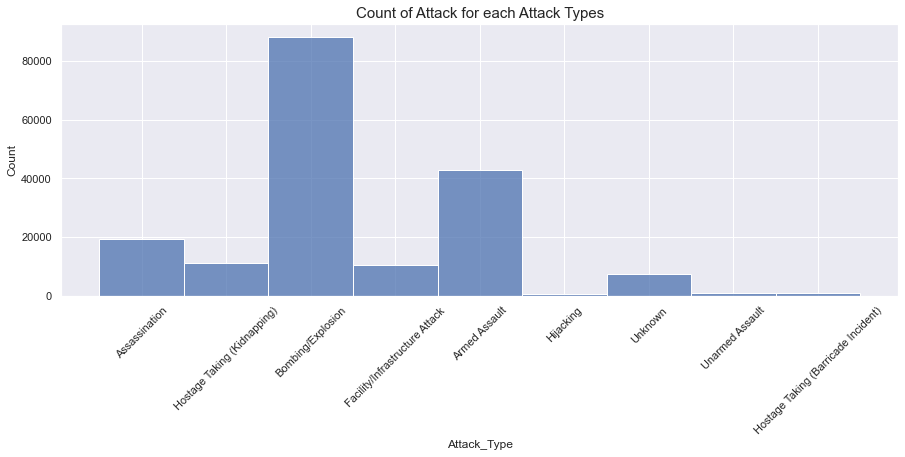

In [22]:
# most attacked types
# Plotting the attack types and no of attack in that type
plt.figure(figsize = (15,5))
sns.histplot(df_new['Attack_Type'], palette='cubehelix')
plt.title('Count of Attack for each Attack Types',fontsize=15)
plt.xticks(rotation=45)
plt.show()

Now Visualizing the count of attack for each attack_type and for each country and printing Top 10 pf them in a bar plot

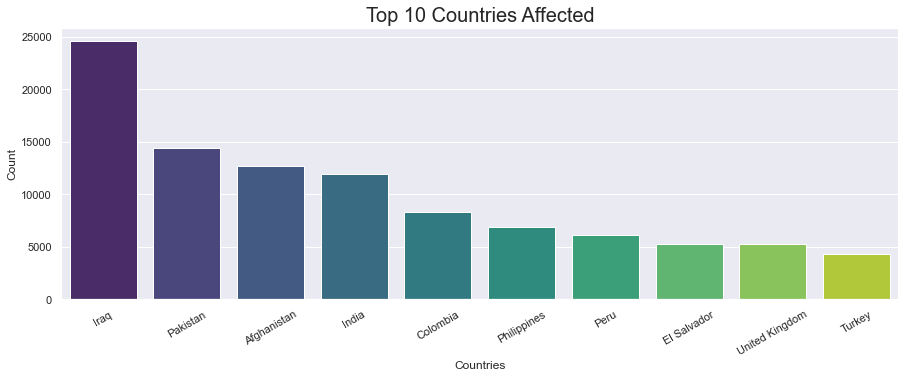

In [23]:
plt.figure(figsize=(15,5))
sns.barplot(df_new['Country'].value_counts()[:10].index,df_new['Country'].value_counts()[:10].values, palette='viridis')
plt.title('Top 10 Countries Affected', fontsize = 20)
plt.xlabel('Countries')
plt.ylabel('Count')
plt.xticks(rotation= 30)
plt.show()

Till Now we have analyzed the Terrorism Attack type and the countries affected most, Now let us visualize what are the target types of the attack. This will give us the result about what are the major areas that could be a possible option for attack in the city.

In [24]:
(df_new['Target_Type'].value_counts().head(10)/df_new['Target_Type'].shape[0])*100

Private Citizens & Property       23.947801
Military                          15.401974
Police                            13.487735
Government (General)              11.713844
Business                          11.375907
Transportation                     3.742068
Utilities                          3.314969
Unknown                            3.246171
Religious Figures/Institutions     2.443709
Educational Institution            2.378764
Name: Target_Type, dtype: float64

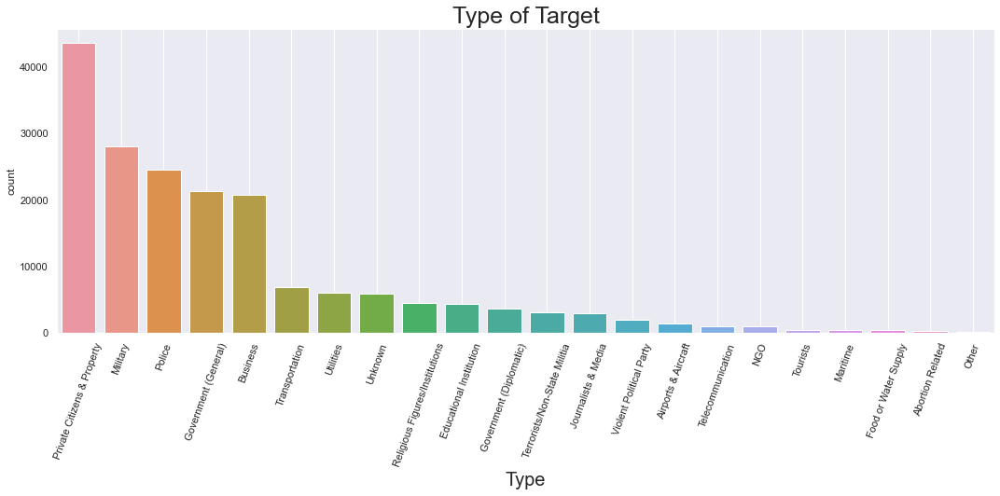

In [25]:
plt.figure(figsize=(18,6))
sns.countplot(x = df_new['Target_Type'], order= df_new['Target_Type'].value_counts().index)
plt.xticks(rotation=70)
plt.xlabel('Type',fontsize = 20)
plt.title('Type of Target', fontsize = 25)
plt.grid()
plt.show()

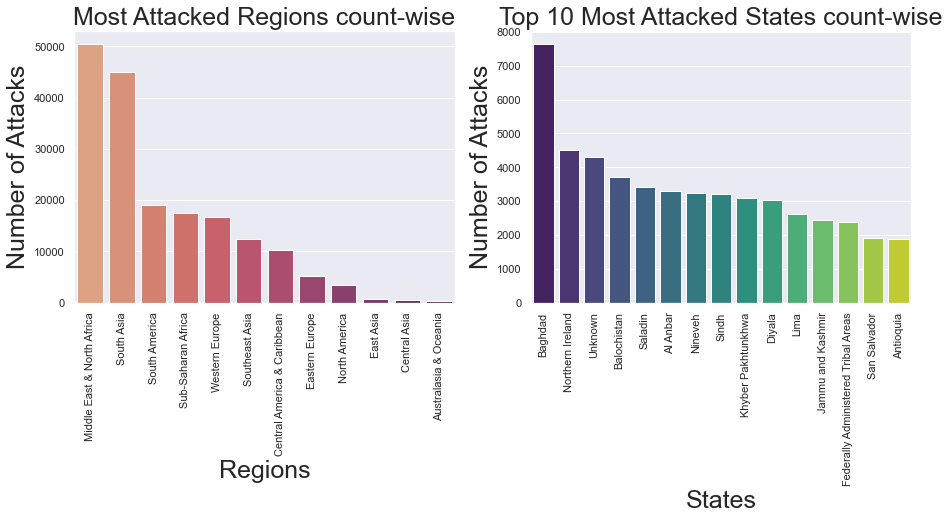

In [26]:
plt.subplot(1,2,1)
# regions with most attacks 
sns.barplot(df_new['Region'].value_counts().index, df_new['Region'].value_counts().values,palette='flare')
plt.title('Most Attacked Regions count-wise',fontsize=25)
plt.xlabel('Regions',fontsize=25)
plt.ylabel('Number of Attacks',fontsize=25)
plt.xticks(rotation=90)

plt.subplot(1,2,2)
sns.barplot(df_new['State'].value_counts().head(15).index, df_new['State'].value_counts().head(15).values,palette='viridis')
plt.title('Top 10 Most Attacked States count-wise',fontsize=25)
plt.xlabel('States',fontsize=25)
plt.ylabel('Number of Attacks',fontsize=25)
plt.xticks(rotation=90)
plt.gcf().set_size_inches(15, 5)

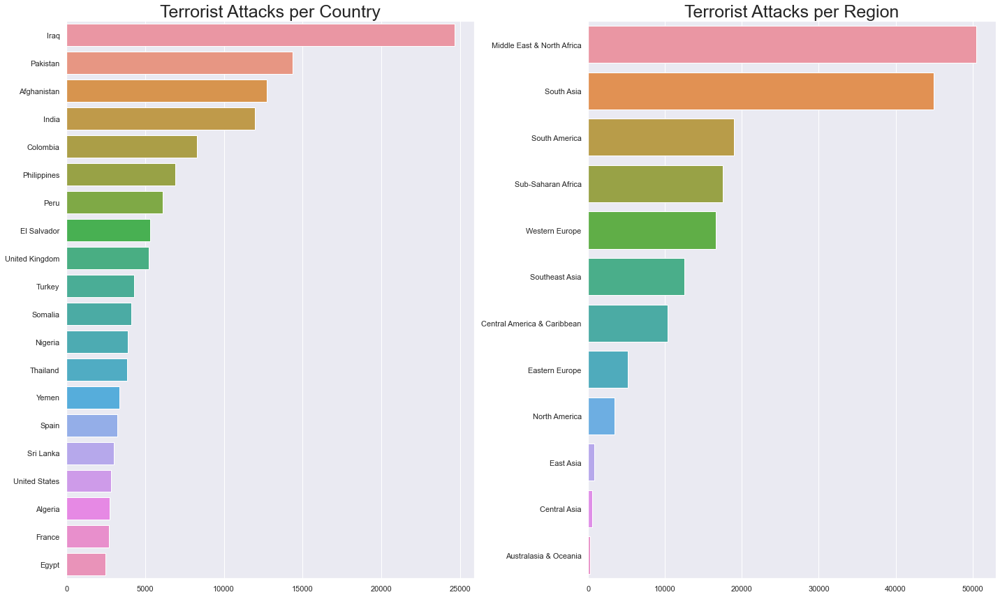

In [27]:
fig,axes = plt.subplots(figsize=(20,12),nrows=1,ncols=2)
sns.barplot(x = df_new['Country'].value_counts()[:20].values, y = df_new['Country'].value_counts()[:20].index, ax=axes[0]);
axes[0].set_title('Terrorist Attacks per Country', fontsize = 25)
sns.barplot(x=df_new['Region'].value_counts().values, y=df_new['Region'].value_counts().index, ax=axes[1])
axes[1].set_title('Terrorist Attacks per Region',fontsize = 25)
fig.tight_layout()
plt.show()

An important part of an attack is the  type of wepons used during the attack, because which type of rescue team needs to send for the rescue mission. 

In [28]:
# Calculating the each type of the wepons used for the attack 
(df_new['Weapon_type'].value_counts().head()/df_new['Weapon_type'].shape[0])*100

Explosives    50.869883
Firearms      32.210731
Unknown        8.342185
Incendiary     6.128537
Melee          2.011657
Name: Weapon_type, dtype: float64

Text(0, 0.5, 'Number of Weapon Used')

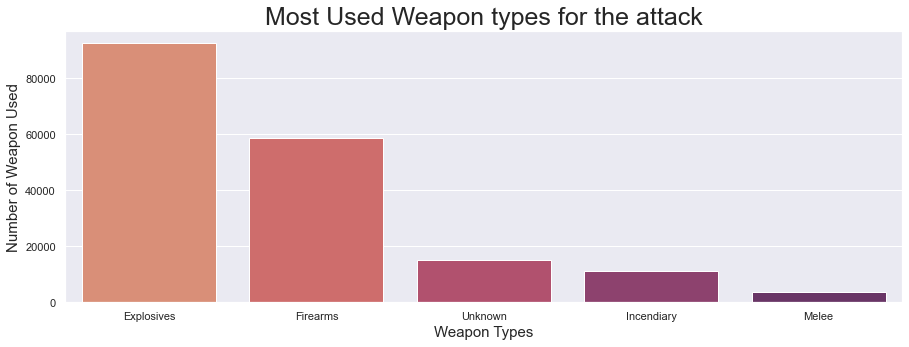

In [29]:
# most used weapons types in terror attacks
plt.figure(figsize=(15,5))
sns.barplot(df_new['Weapon_type'].value_counts().head().index, df_new['Weapon_type'].value_counts().head().values,palette='flare')
plt.title('Most Used Weapon types for the attack',fontsize=25)
plt.xlabel('Weapon Types',fontsize=15)
plt.ylabel('Number of Weapon Used',fontsize=15)


Now let us analyze deaths and casualities for each year and the most active terror group

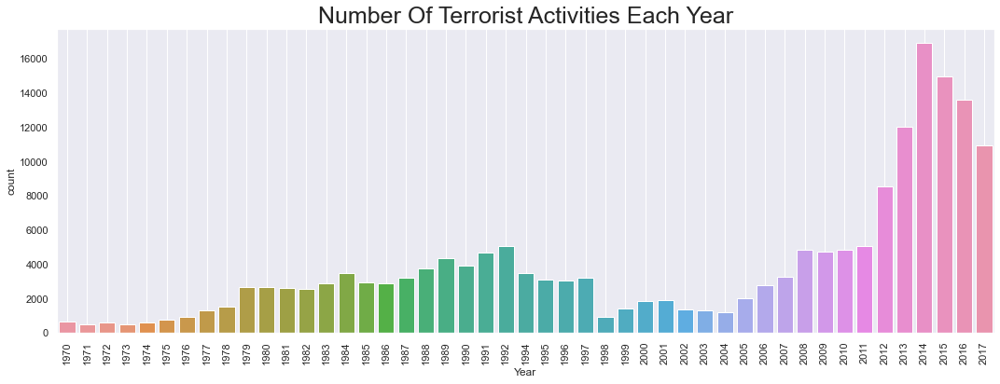

In [30]:
plt.subplots(figsize=(18,6))
sns.countplot('Year',data = df_new)
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year', fontsize = 25)
plt.grid()
plt.show()

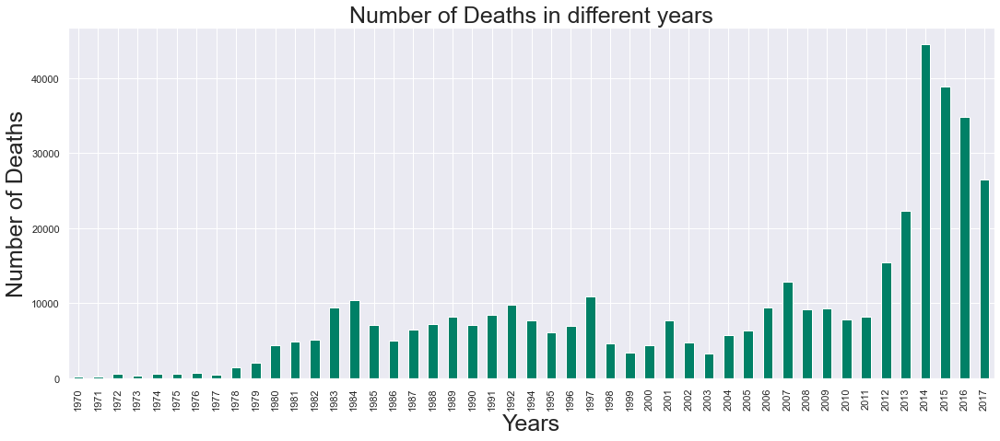

In [31]:
plt.figure(figsize = (18,7))
df_new.groupby(['Year'])['Killed'].sum().plot(kind='bar',colormap='summer')
plt.title('Number of Deaths in different years',fontsize=25)
plt.xlabel('Years',fontsize=25)
plt.ylabel('Number of Deaths',fontsize=25)
plt.xticks(rotation=90)
plt.show()

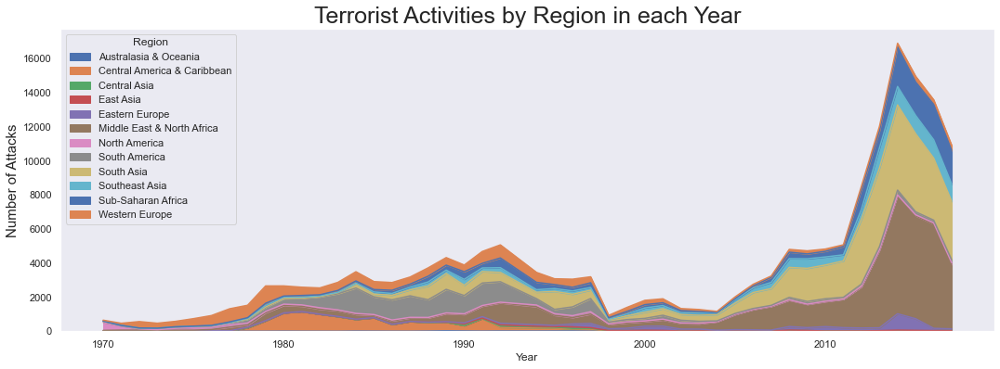

In [32]:
pd.crosstab(df_new.Year, df_new.Region).plot(kind='area',figsize=(18,6))
plt.title('Terrorist Activities by Region in each Year',fontsize = 25)
plt.ylabel('Number of Attacks',fontsize= 15)
plt.grid()
plt.show()

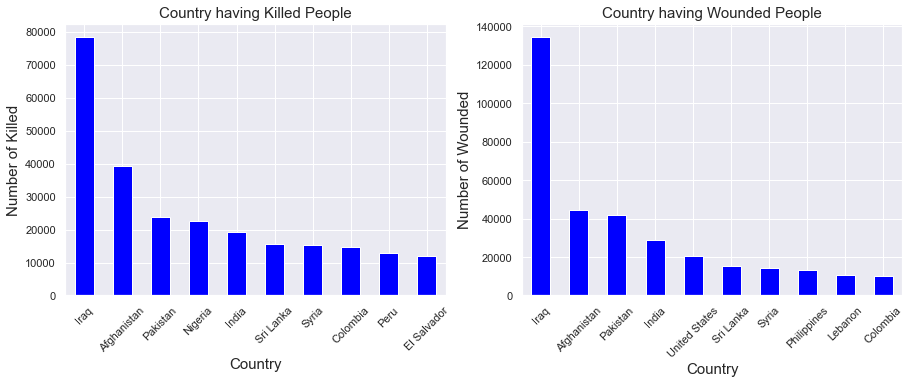

In [33]:
plt.subplot(1,2,2)

df1=df_new.groupby(['Country'])['Wounded'].sum().sort_values(ascending = False).head(10).plot(kind='bar',colormap='winter')
plt.title('Country having Wounded People',fontsize=15)
plt.xlabel('Country',fontsize=15)
plt.ylabel('Number of Wounded',fontsize=15)
plt.xticks(rotation=45)

plt.subplot(1,2,1)
df_new.groupby(['Country'])['Killed'].sum().sort_values(ascending = False).head(10).plot(kind='bar',colormap='winter')
plt.title('Country having Killed People',fontsize=15)
plt.xlabel('Country',fontsize=15)
plt.ylabel('Number of Killed',fontsize=15)
plt.xticks(rotation=45)
plt.gcf().set_size_inches(15, 5)

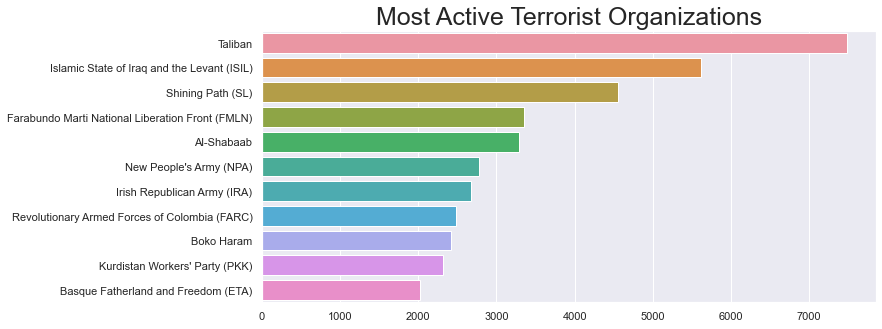

In [34]:
plt.subplots(figsize=(11,5))
sns.barplot(y=df_new['Group'].value_counts()[1:12].index,x=df_new['Group'].value_counts()[1:12].values)
plt.title('Most Active Terrorist Organizations', fontsize = 25)
plt.show()

In [35]:
terr_df_tal = df_new[df_new.Group == 'Taliban']

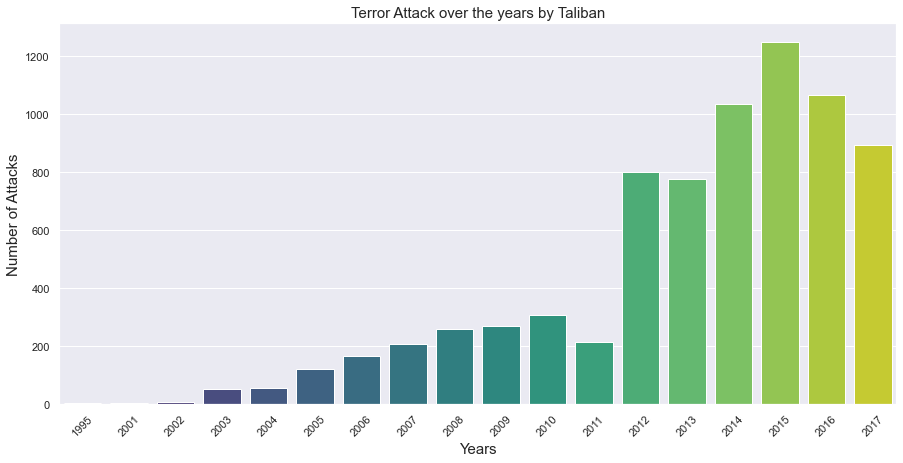

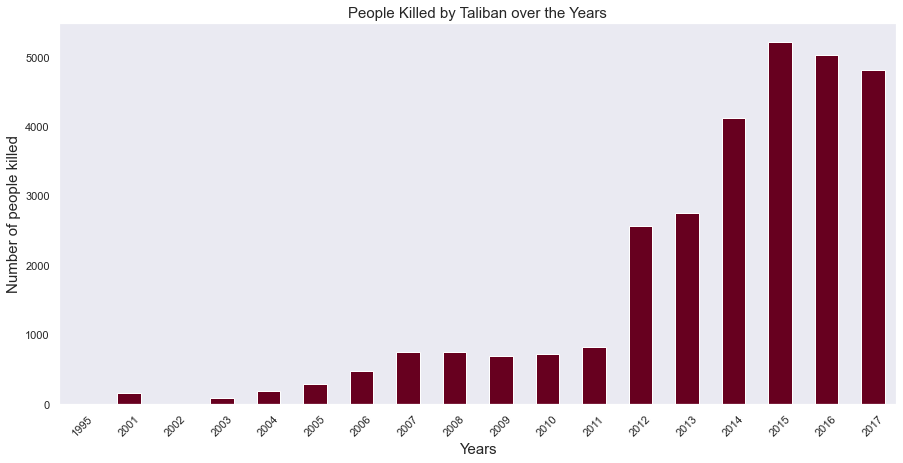

In [36]:
# Terror Attacks by Taliban over the Years
plt.figure(figsize = (15,7))
sns.barplot(terr_df_tal['Year'].value_counts().index,terr_df_tal['Year'].value_counts().values, palette = 'viridis')
plt.title('Terror Attack over the years by Taliban',fontsize=15)
plt.xlabel('Years',fontsize=15)
plt.ylabel('Number of Attacks',fontsize=15)
plt.xticks(rotation= 45)

plt.figure(figsize=(15,7))
terr_df_tal.groupby(['Year'])['Killed'].sum().plot(kind='bar',colormap='RdBu')
plt.title('People Killed by Taliban over the Years',fontsize=15)
plt.xlabel('Years',fontsize=15)
plt.ylabel('Number of people killed',fontsize=15)
plt.xticks(rotation=45)
plt.grid()
plt.show()

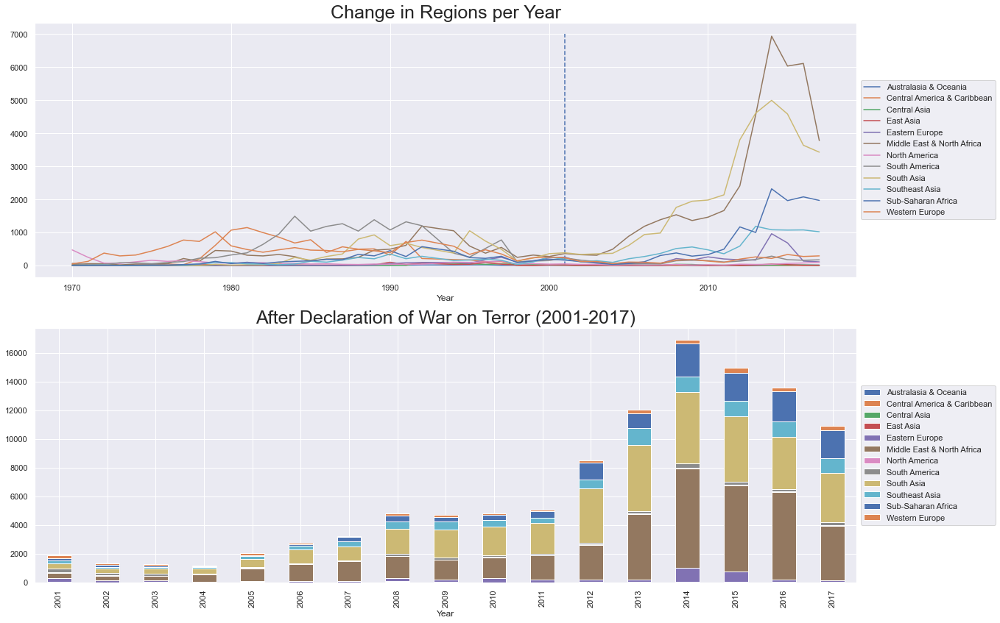

In [37]:
data_after = df_new[df_new['Year']>=2001]
fig,ax = plt.subplots(figsize=(20,14), nrows=2, ncols=1)
ax[0] = pd.crosstab(df_new.Year, df_new.Region).plot(ax=ax[0])
ax[0].set_title('Change in Regions per Year', fontsize = 25)
ax[0].legend(loc='center left', bbox_to_anchor = (1,0.5))
ax[0].vlines(x=2001, ymin=0, ymax=7000, linestyles='--')
pd.crosstab(data_after.Year,data_after.Region).plot.bar(stacked=True, ax=ax[1])
ax[1].set_title('After Declaration of War on Terror (2001-2017)',fontsize = 25)
ax[1].legend(loc='center left', bbox_to_anchor = (1,0.5))
plt.show()

### 4. Final Dashbord 

Year wise animated visualization for the casualities vs Deaths using scatter() function with animation frame

In [38]:
px.scatter(df_new,df_new.Wounded,df_new.Killed,hover_name='Country',animation_frame='Year',animation_group='Country',color='Wounded',
           size='Year',size_max=50,range_color=[0,1],labels={'Killed':'Deaths','Wounded':'Casualities'},
           title='Number of casualities vs Killed people in each country for each year')

Using **plotly.express** , let us create an live world map which shows name of the country and number of the attacks afte hovering over it 

In [39]:
terrorism =df_new.groupby(['Country'],as_index=False).count()


In [40]:

fig=px.choropleth(terrorism,locations='Country',locationmode='country names',
                  color='Year',hover_name='Country',projection='orthographic',
                  title='Attacks countrywise (TOTAL) (1970-2017)',labels={'Year':'Attacks'})
fig.show()

px.choropleth(terrorism,locations='Country',locationmode='country names'
              ,color='Year',hover_name='Country',title='Attacks countrywise (TOTAL) (1970-2017)'
             ,labels={'Year':'Attacks'})

## 5. Terrorism Attacks in INDIA


Let us create a different dataframe from existing with the country name as India and visualize the attacks in India specifically

In [41]:
terr_India = df_new[df_new.Country == "India"]

In [42]:
terr_India

,Year,Month,Day,Country,State,Region,City,Latitude,Longitude,Attack_Type,Killed,Wounded,Group,Target,Target_Type,Weapon_type
1186,1972,2,22,India,Delhi,South Asia,New Delhi,28.585836,77.153336,Hijacking,0,0,Palestinians,B-747,Airports & Aircraft,Explosives
2764,1975,1,2,India,Bihar,South Asia,Samastipur,25.863042,85.781004,Bombing/Explosion,4,0,Ananda Marga,Lalit Narayan Mishra and a legislator,Government (General),Explosives
3857,1976,5,26,India,Delhi,South Asia,New Delhi,28.585836,77.153336,Bombing/Explosion,0,0,Unknown,New Delhi airport,Airports & Aircraft,Explosives
5327,1977,9,28,India,Maharashtra,South Asia,Bombay,19.075984,72.877656,Hijacking,0,0,Japanese Red Army (JRA),DC-8,Airports & Aircraft,Firearms
7337,1979,1,13,India,Assam,South Asia,Unknown,26.200605,92.937574,Armed Assault,0,0,Naga People,patrol,Police,Firearms
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181663,2017,12,30,India,Kerala,South Asia,Koothuparamba,11.831902,75.565432,Bombing/Explosion,0,0,Unknown,Koothuparamba Police Station,Police,Explosives
181665,2017,12,30,India,Chhattisgarh,South Asia,Toylanka,18.802725,81.497666,Facility/Infrastructure Attack,0,0,Communist Party of India - Maoist (CPI-Maoist),Road Construction Site,Business,Firearms
181672,2017,12,31,India,Jammu and Kashmir,South Asia,Lethapora,33.966527,74.964225,Armed Assault,8,3,Jaish-e-Mohammad (JeM),Camp,Police,Explosives
181684,2017,12,31,India,Assam,South Asia,Hungrum,25.180162,93.015788,Hostage Taking (Kidnapping),0,0,Zeliangrong United Front,Personal Security Officer of Council Member Ih...,Government (General),Firearms


In [43]:
terr_India.shape

(11960, 16)

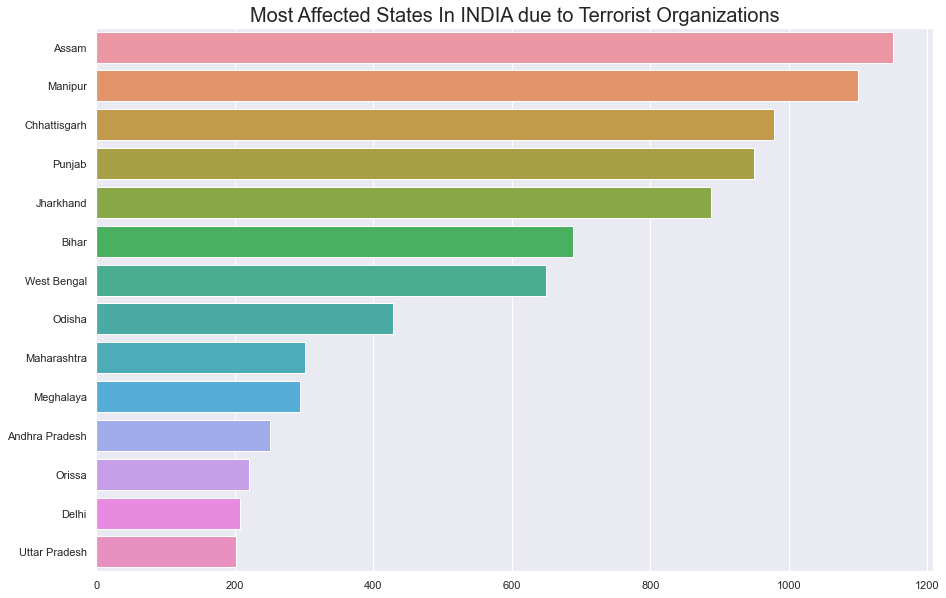

In [44]:
plt.subplots(figsize=(15,10))
sns.barplot(y=terr_India['State'].value_counts()[1:15].index,x=terr_India['State'].value_counts()[1:15].values)
plt.title('Most Affected States In INDIA due to Terrorist Organizations', fontsize = 20)
plt.show()

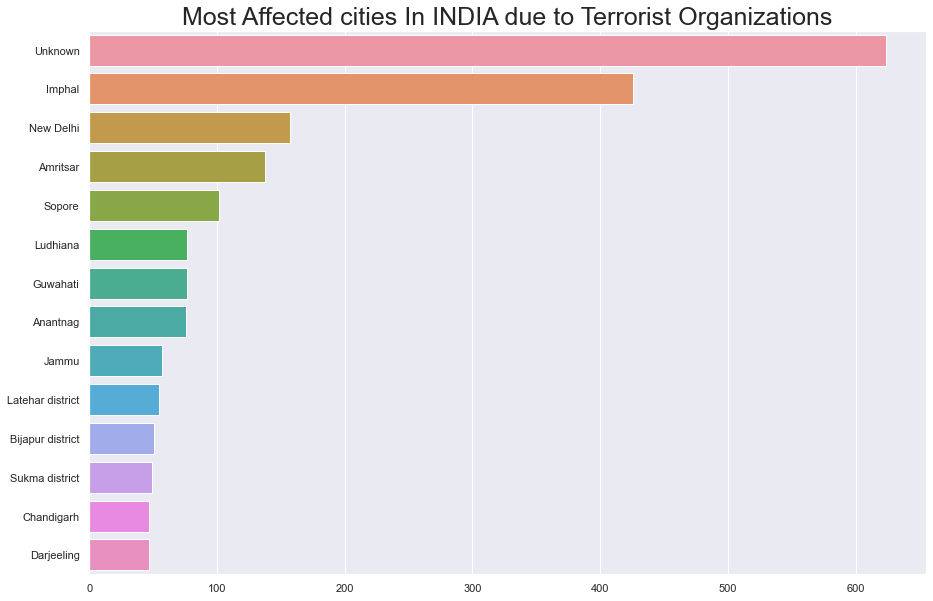

In [45]:
plt.subplots(figsize=(15,10))
sns.barplot(y=terr_India['City'].value_counts()[1:15].index,x=terr_India['City'].value_counts()[1:15].values)
plt.title('Most Affected cities In INDIA due to Terrorist Organizations', fontsize = 25)
plt.show()

**Let us plot all the datapoints in the Table containing the records of terrorism in INDIA and visulaize the location of each attack in India

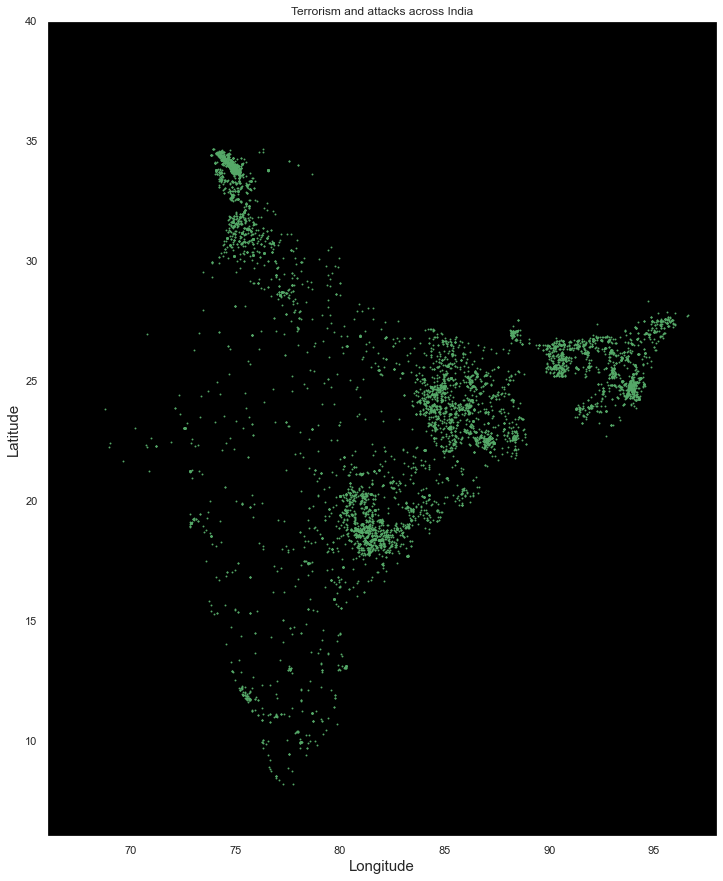

In [46]:
plt.figure(facecolor='white',figsize = (12,15))

# plot all data points on the map of New York
ax = plt.axes()
ax.set_facecolor('black')
plt.plot(terr_India['Longitude'], terr_India['Latitude'], 'go', ms = 0.9)
plt.title("Terrorism and attacks across India")
plt.xlabel('Longitude', fontsize = 15)
plt.ylabel('Latitude',fontsize = 15)

plt.xlim(66, 98)
plt.ylim(6, 40)
plt.grid(False)

## Conclusion

After performing the Exploratory Data Analysis we get the following insights from the data:


* Private Citizens and Property were attacked most followed by Military, Police, Government and so on.
* Middle East & North Africa was most affected among the top affected region. Most of the people in this region were either wounded or killed.
* Iraq was the country which was most affected by terror attacks and had maximum number of killed and wounded people.
* The State and City that was most affected was Baghdad
* In the last decade 2014 had most number of terror attacks. That was around 16500 attacks during this year which means on average 45 attacks per day.
* The most common attack type was Bombing/Explosion.
* Explosives have been consistently the most popular weapon of choice for terrorists.
* Taliban became more active since 2012 and they are responsible for the most of the terror attacks
* Terrorist activities are more in Middle East and North Africa
* Attacks have increased from 2010 in Middle East and South Africa
* Terrorist Organizations have started using Airports And Aircraft and Military as their major target type since 2000's
* Middle East and North Africa seen to have places of serious attacks.
* Iraq, Afghanistan and Pakistan are the most damaged countries.

### Recomendations

* Since Private Citizens and Property are being targeted consistently so stronger security and surveillance should be provided, especially in the dense populated regions.
* More surveillance is required especially in the Middle East & North African Regions.
* Strict border policy should be implemented to prevent the movement of explosives between the regions.

#### Author: Utkarsh Pratap Singh